In [83]:
from sklearn.cluster import KMeans, DBSCAN
from sklearn.preprocessing import StandardScaler, MinMaxScaler, PowerTransformer
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.metrics import homogeneity_completeness_v_measure, homogeneity_score, completeness_score, v_measure_score
from scikitplot.metrics import plot_silhouette
from scikitplot.cluster import plot_elbow_curve
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression, LogisticRegressionCV
from sklearn.model_selection import train_test_split, cross_val_score, KFold
from sklearn.metrics import classification_report
from sklearn.metrics import roc_auc_score, average_precision_score, plot_roc_curve, plot_precision_recall_curve

In [84]:
import warnings
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(font_scale=1.5)
pd.options.display.max_rows = 4000
pd.options.display.max_columns = 4000

%config InlineBackend.figure_format = 'retina'
%matplotlib inline

warnings.simplefilter('ignore')

In [85]:
data = pd.read_csv('data-eth-15min.csv')
#data.drop('Date.1',axis=1,inplace=True)
data.index = pd.DatetimeIndex(data['Date'])
data.drop('Date',axis=1,inplace=True)

In [86]:
data = data[-100000:]

In [87]:
data['Return_1h'] = data['Close'].pct_change(4).shift(-5)
data['BuyorSell'] = [-1 if x <= 0 else 1 for x in data['Return_1h']]
data.dropna(axis=0,inplace=True)

In [88]:
#Creates new moving averages
def EMAS_TA(df,col,ma1,ma2):
    if (type(ma1) or type(ma2)) != int:
        print('ma1 and ma2 are not integer')
    elif ma1 > ma2:
        print('ma1 needs to be smaller than ma2')
    else:
        a = col + '_' + str(ma1) + 'MA'
        b = col + '_' + str(ma2) + 'MA'
        df[a] = df[col].ewm(span=ma1,adjust=True).mean()
        df[b] = df[col].ewm(span=ma2,adjust=True).mean()
        c = 'diff' + str(a) + '_' + str(b) 
        df[c] = df[b] - df[a]
    return

In [89]:
#create exp moving average for 1 week vs 2 weeks
EMAS_TA(data,'Close',60,96)

In [90]:
#New features
data['Diff_Close_Open'] = data.Close - data.Open
data['Diff_Close_avg'] = data.Close - data.avg

In [91]:
data.dropna(axis=0,inplace=True)

In [92]:
#other features, position of Close price vs moving averages
data['Dist_Close_STmas'] = data.Close - data.Close_8MA
data['Dist_Close_LTmas'] = data.Close - data.Close_16MA

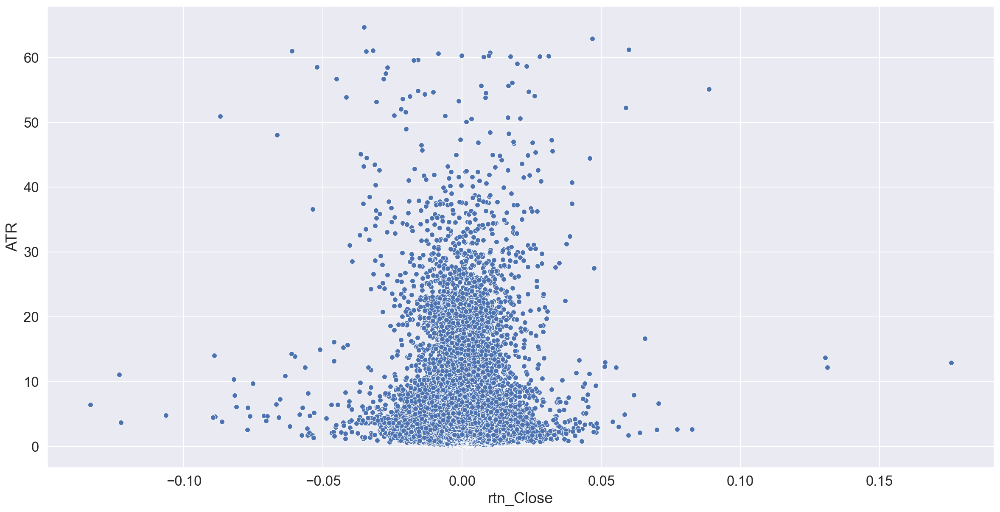

In [93]:
#Check relationship between chosen features
fig, ax = plt.subplots(figsize=(20,10))
sns.scatterplot(data=data,x='rtn_Close', y='ATR',ax=ax)
plt.show()

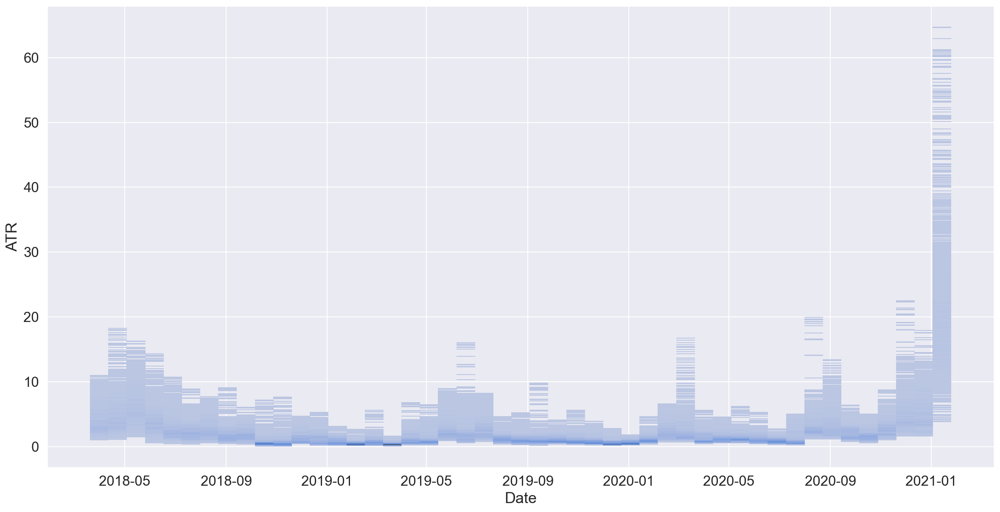

In [94]:
fig, ax = plt.subplots(figsize=(20,10))
sns.histplot(data=data,x=data.index, y='ATR',ax=ax)
plt.show()

In [95]:
y = data['BuyorSell'].copy()

In [96]:
data.columns

Index(['Open', 'High', 'Low', 'Close', 'Volume', 'avg', 'rtn_Close',
       'abs_rtn_Close', 'Close_std8', 'Close_std16', 'abs_rtn_Close_8MA',
       'abs_rtn_Close_16MA', 'Close_8EMA', 'Close_16EMA', 'Close_8MA',
       'Close_16MA', 'Diff_Close_16EMAClose_8EMA', 'BolUpClose_8MA',
       'BolDnClose_8MA', 'BolUpClose_16MA', 'BolDnClose_16MA', 'rtn_Volume',
       'abs_rtn_Volume', 'Volume_std8', 'Volume_std16', 'abs_rtn_Volume_8MA',
       'abs_rtn_Volume_16MA', 'Volume_8EMA', 'Volume_16EMA', 'Volume_8MA',
       'Volume_16MA', 'Diff_Volume_16EMAVolume_8EMA', 'BolUpVolume_8MA',
       'BolDnVolume_8MA', 'BolUpVolume_16MA', 'BolDnVolume_16MA', 'rtn_avg',
       'abs_rtn_avg', 'avg_std8', 'avg_std16', 'abs_rtn_avg_8MA',
       'abs_rtn_avg_16MA', 'avg_8EMA', 'avg_16EMA', 'avg_8MA', 'avg_16MA',
       'Diff_avg_16EMAavg_8EMA', 'BolUpavg_8MA', 'BolDnavg_8MA',
       'BolUpavg_16MA', 'BolDnavg_16MA', 'RSI_Close', 'Volume_ratio',
       'Close_MAs_ratio', 'DnBol_Dist_16', 'UpBol_Dist_16', '

In [97]:
'''X = data[['Volume','Diff_Close_24EMAClose_12EMA','rtn_Volume','Volume_std12',
'Volume_std24','Diff_Volume_24EMAVolume_12EMA','avg_std12','avg_std24',
'Diff_avg_24EMAavg_12EMA','RSI_Close','Volume_ratio','Close_MAs_ratio','DnBol_Dist_24',
'UpBol_Dist_24','Dist_BolDn_BolUp','ATR','Dist_Close_STmas','Dist_Close_LTmas',
'diffClose_168MA_Close_336MA','Diff_Close_Open']].copy()

SyntaxError: EOF while scanning triple-quoted string literal (<ipython-input-97-48d3445f2d3a>, line 5)

In [98]:
X = data[['Diff_Close_16EMAClose_8EMA','RSI_Close',
       'Close_MAs_ratio', 'DnBol_Dist_16', 'UpBol_Dist_16',
       'ATR',
       'diffClose_60MA_Close_96MA']].copy()
#X['rtn_Close_prev'] = data.rtn_Close.shift(1).fillna(0)

<AxesSubplot:>

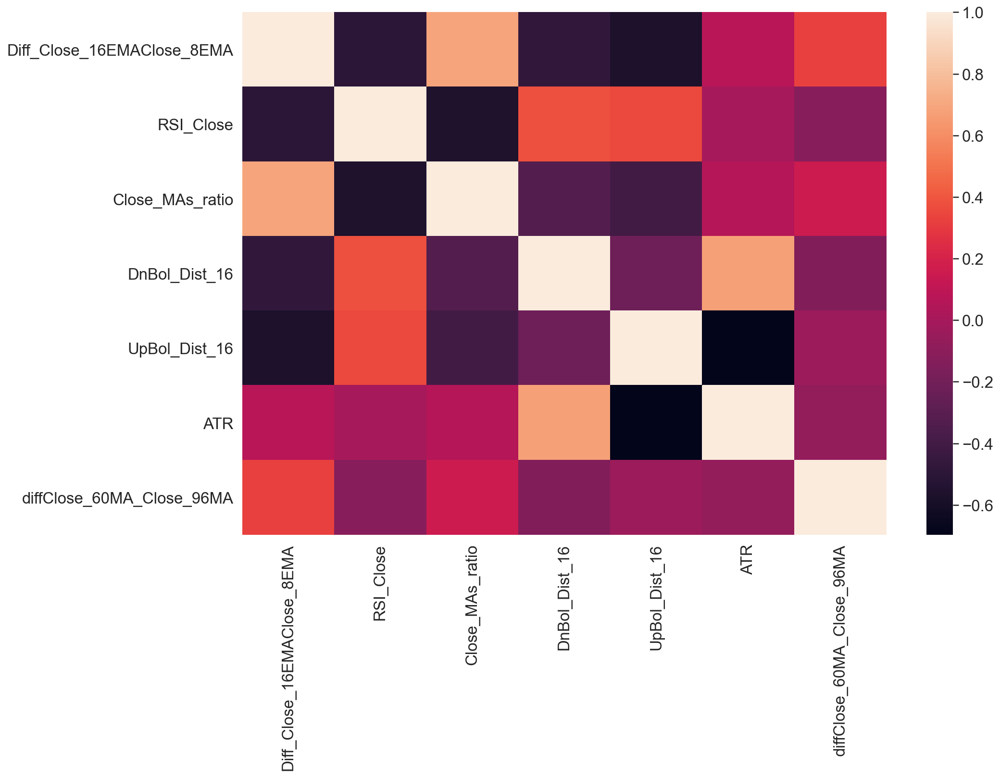

In [99]:
plt.figure(figsize=(15,10))
sns.heatmap(X.corr())#,annot=True)

In [100]:
data.shape

(99995, 68)

In [101]:
scaler1 = StandardScaler()
scaler2 = MinMaxScaler()
Xstd = scaler2.fit_transform(X)

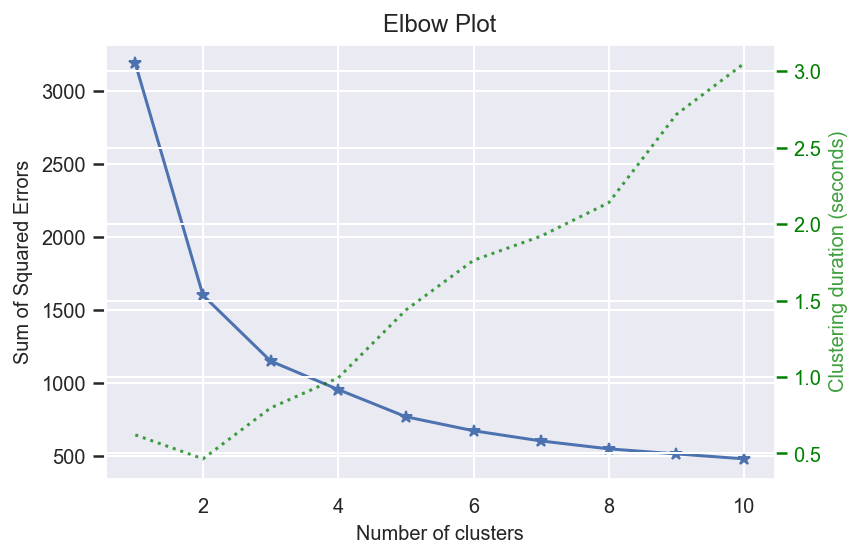

In [102]:
knn = KMeans(n_clusters=3, random_state=1)
plot_elbow_curve(knn, Xstd, cluster_ranges=range(1, 11))
plt.show()

In [103]:
from matplotlib.colors import ListedColormap
import matplotlib.cm as cm
from tqdm import tqdm

100%|███████████████████████████████████████████████████████████████████████████████████| 4/4 [22:10<00:00, 332.51s/it]


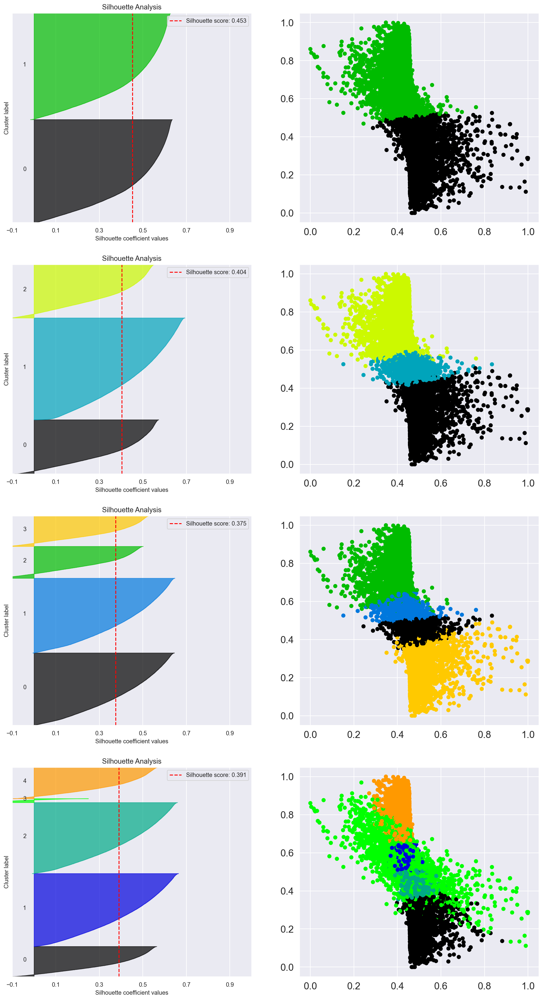

In [35]:
#Looking at clustering model to see if some patterns emerge. Ideally I am selecting features so the model can clustering 
# support and resistance

silhouette = []

fig, ax = plt.subplots(nrows=4, ncols=2, figsize=(16, 30))

for k in tqdm(range(2, 6)):

    model = KMeans(n_clusters=k, random_state=1)
    labels = model.fit_predict(Xstd)
    silhouette.append((k, silhouette_score(Xstd, labels)))

    colors = cm.nipy_spectral(labels.astype(float) / k)
    plot_silhouette(Xstd, labels, ax=ax[k-2, 0])
    ax[k-2, 1].scatter(Xstd[:, 0], Xstd[:, 1], color=colors)

silhouette = np.array(silhouette)

In [104]:
model = KMeans(n_clusters=2
    , random_state=1)
model.fit(Xstd)
labels = model.predict(Xstd)

In [105]:
df = pd.DataFrame(labels,columns=['Labels'])

In [106]:
df['Close'] = data.Close.values

In [107]:
df.set_index(data.index,inplace=True)

In [40]:
df.Labels.value_counts()

1    50834
0    49161
Name: Labels, dtype: int64

In [108]:
import plotly.graph_objects as go

layout = dict(title='ETH',
              plot_bgcolor='white',
              margin=dict(t=60, b=40, l=20, r=20),
              xaxis=dict(linecolor='gray', mirror=True, showgrid=False),
              yaxis=dict(linecolor='gray', mirror=True, showgrid=False),
                                 )

Chart = []

Chart.append(go.Scatter(x=data.index,
                       y=data['Close'],
                       name='Price',
                       mode='lines',
                       line=dict(color='lime', width=1)))

#Chart.append(go.Scatter(x=data.index,
 #                      y=data['Close_60MA'],
  #                     name='60MA',
   #                    mode='lines',
    #                   line=dict(color='grey', width=1)))

Chart.append(go.Scatter(x=df.query('Labels == 2').index,
                       y=df.query('Labels == 2')['Close'],
                     name='avg, Labels = 2',
                       mode='markers',
                       marker=dict(color='purple', size=5)))

Chart.append(go.Scatter(x=df.query('Labels == 1').index,
                       y=df.query('Labels == 1')['Close'],
                       name='avg, Labels = 1',
                       mode='markers',
                       marker=dict(color='orange', size=5)))

Chart.append(go.Scatter(x=df.query('Labels == 0').index,
                       y=df.query('Labels == 0')['Close'],
                       name='avg, Labels = 0',
                       mode='markers',
                       marker=dict(color='blue', size=5)))

Chart.append(go.Scatter(x=df.query('Labels == 3').index,
                       y=df.query('Labels == 3')['Close'],
                       name='avg, Labels = 3',
                       mode='markers',
                       marker=dict(color='yellow', size=5)))



fig = go.Figure(data=Chart, layout=layout)

fig.show()

In [246]:
from plotly.subplots import make_subplots
fig = make_subplots(rows=2, cols=1, shared_xaxes=True, 
               vertical_spacing=0.03, subplot_titles=('Price', 'Vol'), 
               row_width=[0.4, 0.97])

# Plot OHLC on 1st row
fig.add_trace(go.Scatter(x=data.index,
                       y=data['Close'],
                       name='avg',
                       mode='lines',
                       line=dict(color='lime', width=1)))

#Chart.append(go.Scatter(x=data.index,
 #                      y=data['Close_60MA'],
  #                     name='60MA',
   #                    mode='lines',
    #                   line=dict(color='grey', width=1)))

fig.add_trace(go.Scatter(x=df.query('Labels == 2').index,
                       y=df.query('Labels == 2')['Close'],
                     name='Labels = 2',
                       mode='markers',
                       marker=dict(color='purple', size=5)))

fig.add_trace(go.Scatter(x=df.query('Labels == 1').index,
                       y=df.query('Labels == 1')['Close'],
                       name='Labels = 1',
                       mode='markers',
                       marker=dict(color='orange', size=5)))

fig.add_trace(go.Scatter(x=df.query('Labels == 0').index,
                       y=df.query('Labels == 0')['Close'],
                       name='Labels = 0',
                       mode='markers',
                       marker=dict(color='blue', size=5)))

fig.add_trace(go.Scatter(x=df.query('Labels == 3').index,
                       y=df.query('Labels == 3')['Close'],
                       name='Labels = 3',
                       mode='markers',
                       marker=dict(color='blue', size=5)))


# Bar trace for volumes on 2nd row without legend
fig.add_trace(go.Scatter(x=data.index, y=data['Volume'], showlegend=False), row=2, col=1)

# Do not show OHLC's rangeslider plot 
fig.update_layout(height=1000, width=1000)
fig.update(layout_xaxis_rangeslider_visible=False)
fig.show()

dbscan = DBSCAN(eps=0.5, min_samples=7)
dbscan.fit(Xstd)

In [83]:
print("Labels:")
labels_db = dbscan.labels_
print(labels)

Labels:
[2 2 2 ... 1 1 1]


In [84]:
print(dbscan.core_sample_indices_)

[    0     1     2 ... 41082 41083 41084]


In [85]:
core_samples = np.zeros_like(labels_db, dtype=bool)

In [86]:
core_samples

array([False, False, False, ..., False, False, False])

In [92]:
core_samples[dbscan.core_sample_indices_] = True
core_samples

array([ True,  True,  True, ...,  True,  True,  True])

In [93]:
print("Core samples")
print((core_samples * 1))

Core samples
[1 1 1 ... 1 1 1]


In [94]:
df_dbscan = pd.DataFrame(labels_db,columns=['Labels'])
df_dbscan['Close'] = data.Close.values
df_dbscan.set_index(data.index,inplace=True)

In [95]:
df_dbscan.Labels.value_counts()

 0    41013
-1       72
Name: Labels, dtype: int64

In [56]:
import plotly.graph_objects as go

layout = dict(title='BTC',
              plot_bgcolor='white',
              margin=dict(t=60, b=40, l=20, r=20),
              xaxis=dict(linecolor='gray', mirror=True, showgrid=False),
              yaxis=dict(linecolor='gray', mirror=True, showgrid=False))

Chart = []

Chart.append(go.Scatter(x=data.index,
                       y=data['Close'],
                       name='Close Price',
                       mode='lines',
                       line=dict(color='gold', width=1)))

#Chart.append(go.Scatter(x=data.index,
 #                      y=data['Close_60MA'],
  #                     name='60MA',
   #                    mode='lines',
    #                   line=dict(color='grey', width=1)))

#Chart.append(go.Scatter(x=df_dbscan.query('Labels == 1').index,
 #                      y=df_dbscan.query('Labels == 1')['Close'],
  #                     name='avg, Labels = 1',
   #                    mode='markers',
    #                   marker=dict(color='purple', size=8)))

#Chart.append(go.Scatter(x=df_dbscan.query('Labels == -1').index,
 #                      y=df_dbscan.query('Labels == -1')['Close'],
  #                     name='avg, Labels = 0',
   #                    mode='markers',
    #                   marker=dict(color='orange', size=8)))

#Chart.append(go.Scatter(x=df_dbscan.query('Labels == 0').index,
 #                      y=df_dbscan.query('Labels == 0')['Close'],
  #                     name='avg, Labels = 2',
   #                    mode='markers',
    #                   marker=dict(color='blue', size=8)))

fig = go.Figure(data=Chart, layout=layout)

fig.show()

In [109]:
##### Trying to model my target variable y by selecting relevant features and also adding my labels from the clustering
kf = KFold(n_splits=5, shuffle=True, random_state=2)
RFC = RandomForestClassifier(n_estimators=100,max_features=0.825,random_state=2)

In [110]:
#X2 = data[['Diff_Close_24EMAClose_12EMA','rtn_Volume','Diff_Volume_24EMAVolume_12EMA',
 #   'RSI_Close','Volume_ratio','DnBol_Dist_24',
#'UpBol_Dist_24','Dist_BolDn_BolUp','ATR','Dist_Close_STmas','Dist_Close_LTmas']].copy()
#X2['Labels'] = labels
#X2.shape

In [111]:
#daily
X2 = data[['Diff_Close_16EMAClose_8EMA','Diff_Volume_16EMAVolume_8EMA',
    'RSI_Close','Volume_ratio','DnBol_Dist_16',
    'UpBol_Dist_16','Dist_BolDn_BolUp','ATR','Dist_Close_STmas',
           'Dist_Close_LTmas','diffClose_60MA_Close_96MA']].copy()
#X2['rtn_Close_prev'] = data.rtn_Close.shift(1).fillna(0)
#X2['RSI_Close_prev'] = data.RSI_Close.diff().shift(1).fillna(0)
X2['rtn_Close_ma'] = data.rtn_Close.rolling(window=8).mean().fillna(0)

X2['Labels'] = labels
X2.shape

(99995, 13)

In [112]:
X2.Labels.value_counts()

0    50517
1    49478
Name: Labels, dtype: int64

In [113]:
X2_dum = pd.get_dummies(X2,columns=['Labels'],drop_first=True)

In [114]:
y.head(2)

Date
2018-03-20 08:15:00    1
2018-03-20 08:30:00    1
Name: BuyorSell, dtype: int64

In [115]:
y.value_counts(normalize=True)

 1    0.500375
-1    0.499625
Name: BuyorSell, dtype: float64

In [116]:
scl1 = StandardScaler()
scl2 = MinMaxScaler()

In [117]:
X_train, X_test, y_train, y_test = train_test_split(X2_dum,y,test_size=0.3,stratify=y,random_state=2)
Xstd_train1 = pd.DataFrame(scl2.fit_transform(X_train),columns=X2_dum.columns,index=X_train.index)
Xstd_test1 = pd.DataFrame(scl2.transform(X_test),columns=X2_dum.columns,index=X_test.index)

In [118]:
RFC.fit(Xstd_train1,y_train)

RandomForestClassifier(max_features=0.825, random_state=2)

In [119]:
print(RFC.score(Xstd_train1, y_train))
print(cross_val_score(RFC, Xstd_train1, y_train, cv=5).mean())
print(RFC.score(Xstd_test1, y_test))

1.0
0.5531602349147388
0.5505183506116871


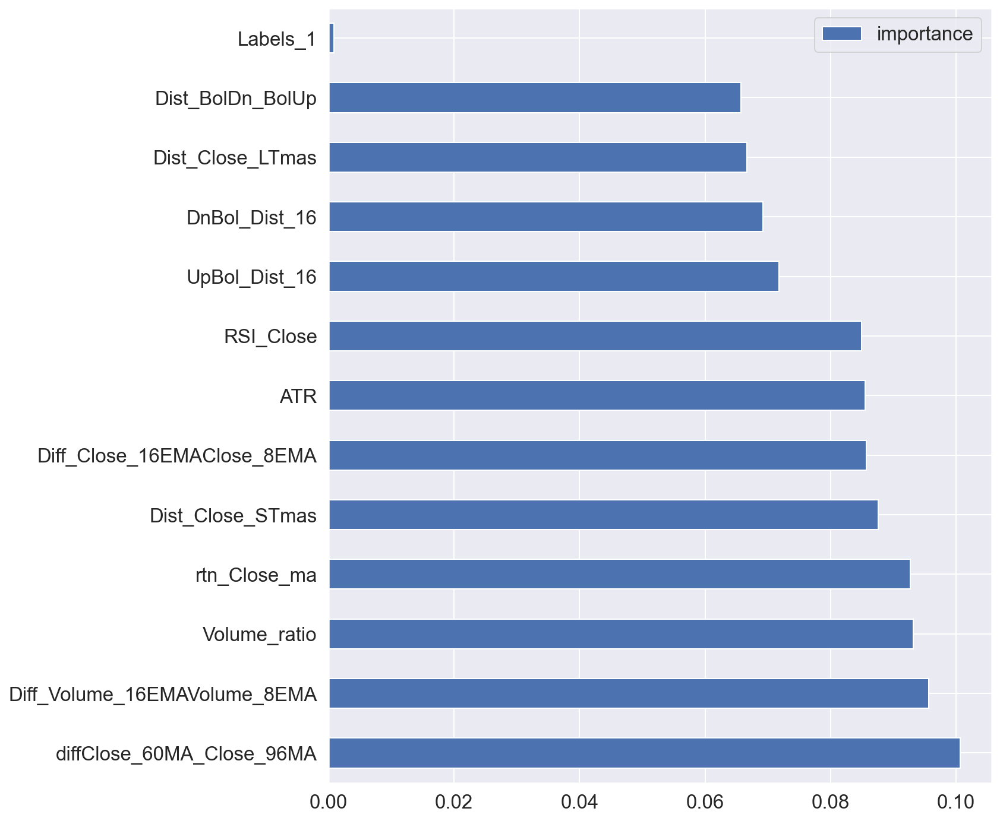

In [120]:
pd.DataFrame(RFC.feature_importances_,
             columns=['importance'],
             index=X2_dum.columns
             ).sort_values(by='importance', ascending=False
                           ).plot(kind='barh', figsize=(10, 12))
plt.show()

In [278]:
from sklearn.model_selection import GridSearchCV

In [73]:
params_RFC = {'max_samples': np.linspace(0.3, 1.0, 5),
          'max_features': range(int(1/2.*Xstd_train1.shape[1]), Xstd_train1.shape[1]+1),
           'n_estimators': [100]}

grid_rfc = GridSearchCV(RFC, param_grid=params_RFC, cv=5, n_jobs=-2,verbose=10)
grid_rfc.fit(Xstd_train1, y_train)
grid_rfc.best_params_

Fitting 5 folds for each of 40 candidates, totalling 200 fits


[Parallel(n_jobs=-2)]: Using backend LokyBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done   4 tasks      | elapsed:   12.7s
[Parallel(n_jobs=-2)]: Done  11 tasks      | elapsed:   30.4s
[Parallel(n_jobs=-2)]: Done  18 tasks      | elapsed:   35.4s
[Parallel(n_jobs=-2)]: Done  27 tasks      | elapsed:   56.0s
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-2)]: Done  47 tasks      | elapsed:  1.7min
[Parallel(n_jobs=-2)]: Done  58 tasks      | elapsed:  2.2min
[Parallel(n_jobs=-2)]: Done  71 tasks      | elapsed:  2.7min
[Parallel(n_jobs=-2)]: Done  84 tasks      | elapsed:  3.3min
[Parallel(n_jobs=-2)]: Done  99 tasks      | elapsed:  4.0min
[Parallel(n_jobs=-2)]: Done 114 tasks      | elapsed:  5.0min
[Parallel(n_jobs=-2)]: Done 131 tasks      | elapsed:  5.7min
[Parallel(n_jobs=-2)]: Done 148 tasks      | elapsed:  6.7min
[Parallel(n_jobs=-2)]: Done 167 tasks      | elapsed:  7.9min
[Parallel(n_jobs=-2)]: Done 186 tasks      | elapsed:  9

{'max_features': 7, 'max_samples': 0.825, 'n_estimators': 100}

In [121]:
from sklearn.metrics import  plot_confusion_matrix, plot_roc_curve, plot_precision_recall_curve, roc_auc_score, average_precision_score

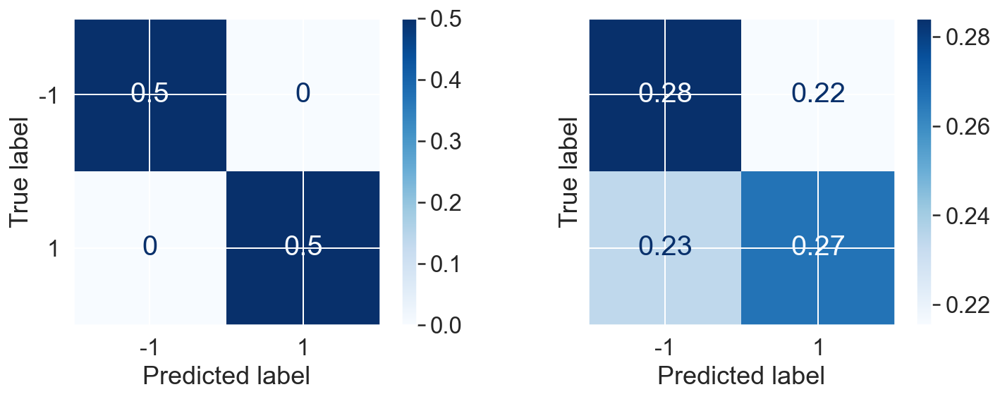

In [122]:
fig, ax = plt.subplots(ncols=2, figsize=(12, 4), sharey=True)
plot_confusion_matrix(RFC, Xstd_train1, y_train, cmap='Blues', ax=ax[0], normalize='all')
plot_confusion_matrix(RFC, Xstd_test1, y_test, cmap='Blues', ax=ax[1], normalize='all')

for a in ax:
    texts = a.texts
    for text in texts:
        text.set_size(20)

plt.show()

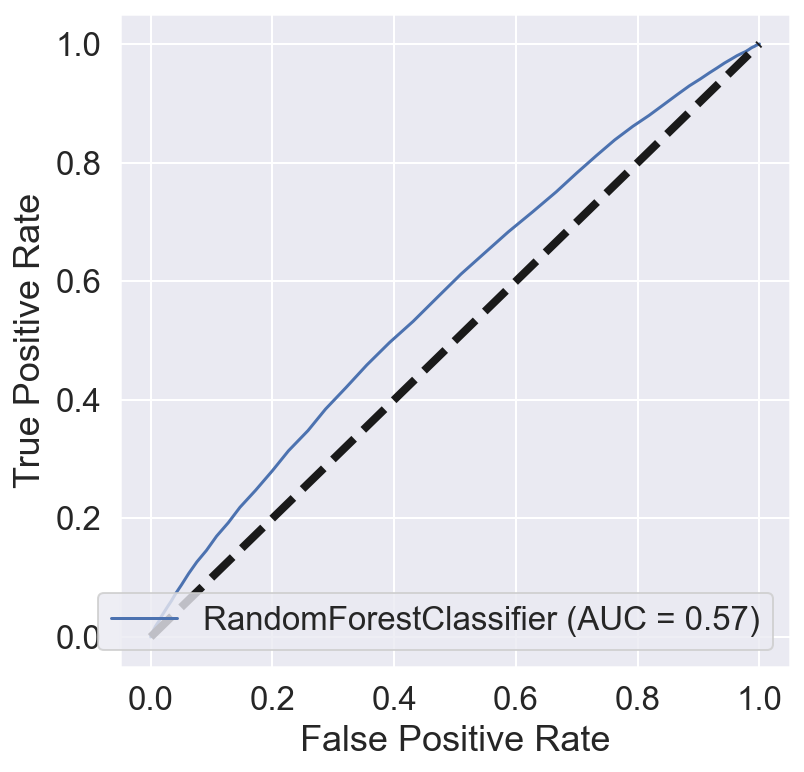

In [123]:
fig, ax = plt.subplots(figsize=(6, 6))
plot_roc_curve(RFC, Xstd_test1, y_test, ax=ax)
ax.plot([0, 1], [0, 1], 'k--', linewidth=4)
plt.show()

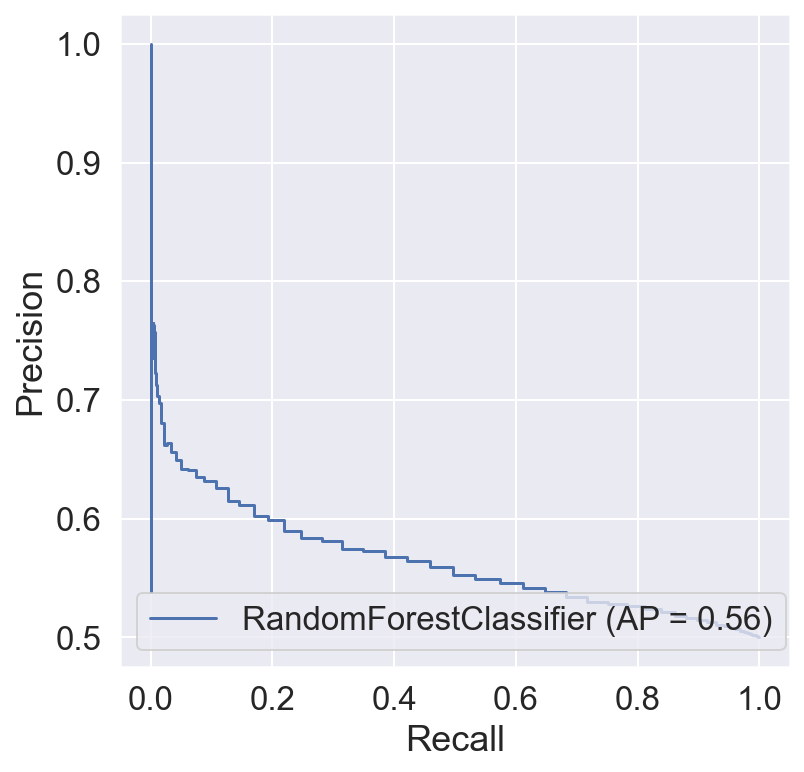

In [124]:
plt.fig, ax = plt.subplots(figsize=(6, 6))
plot_precision_recall_curve(RFC, Xstd_test1, y_test, ax=ax)
plt.show()

In [125]:
from sklearn.metrics import classification_report
print(classification_report(y_test, RFC.predict(Xstd_test1)))

              precision    recall  f1-score   support

          -1       0.55      0.57      0.56     14988
           1       0.55      0.53      0.54     15011

    accuracy                           0.55     29999
   macro avg       0.55      0.55      0.55     29999
weighted avg       0.55      0.55      0.55     29999



In [64]:
from sklearn.ensemble import BaggingClassifier

In [65]:
LogReg = LogisticRegressionCV(solver='saga')

In [66]:
from sklearn.tree import DecisionTreeClassifier
dt = DecisionTreeClassifier()

In [126]:
bagging = BaggingClassifier(base_estimator=dt,
                            max_samples=1.0, 
                            max_features=1.0, 
                            n_estimators=200,
                            verbose =10)

In [127]:
print("Bagging CV training score:\t", 
      cross_val_score(bagging, Xstd_train1, y_train,
                    cv=5, n_jobs=-2).mean())

bagging.fit(Xstd_train1, y_train)
print("Clf bagging training score:\t", bagging.score(Xstd_train1, y_train))
print("Clf bagging test score:\t", bagging.score(Xstd_test1, y_test))

Bagging CV training score:	 0.5547175390078882
Building estimator 1 of 200 for this parallel run (total 200)...


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Building estimator 2 of 200 for this parallel run (total 200)...
Building estimator 3 of 200 for this parallel run (total 200)...
Building estimator 4 of 200 for this parallel run (total 200)...
Building estimator 5 of 200 for this parallel run (total 200)...
Building estimator 6 of 200 for this parallel run (total 200)...
Building estimator 7 of 200 for this parallel run (total 200)...
Building estimator 8 of 200 for this parallel run (total 200)...
Building estimator 9 of 200 for this parallel run (total 200)...
Building estimator 10 of 200 for this parallel run (total 200)...
Building estimator 11 of 200 for this parallel run (total 200)...
Building estimator 12 of 200 for this parallel run (total 200)...
Building estimator 13 of 200 for this parallel run (total 200)...
Building estimator 14 of 200 for this parallel run (total 200)...
Building estimator 15 of 200 for this parallel run (total 200)...
Building estimator 16 of 200 for this parallel run (total 200)...
Building estimator

Building estimator 126 of 200 for this parallel run (total 200)...
Building estimator 127 of 200 for this parallel run (total 200)...
Building estimator 128 of 200 for this parallel run (total 200)...
Building estimator 129 of 200 for this parallel run (total 200)...
Building estimator 130 of 200 for this parallel run (total 200)...
Building estimator 131 of 200 for this parallel run (total 200)...
Building estimator 132 of 200 for this parallel run (total 200)...
Building estimator 133 of 200 for this parallel run (total 200)...
Building estimator 134 of 200 for this parallel run (total 200)...
Building estimator 135 of 200 for this parallel run (total 200)...
Building estimator 136 of 200 for this parallel run (total 200)...
Building estimator 137 of 200 for this parallel run (total 200)...
Building estimator 138 of 200 for this parallel run (total 200)...
Building estimator 139 of 200 for this parallel run (total 200)...
Building estimator 140 of 200 for this parallel run (total 200

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:  3.2min remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:  3.2min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    4.6s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    4.6s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Clf bagging training score:	 1.0
Clf bagging test score:	 0.5585852861762058


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.9s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.9s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    4.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    4.5s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.8s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.8s finished


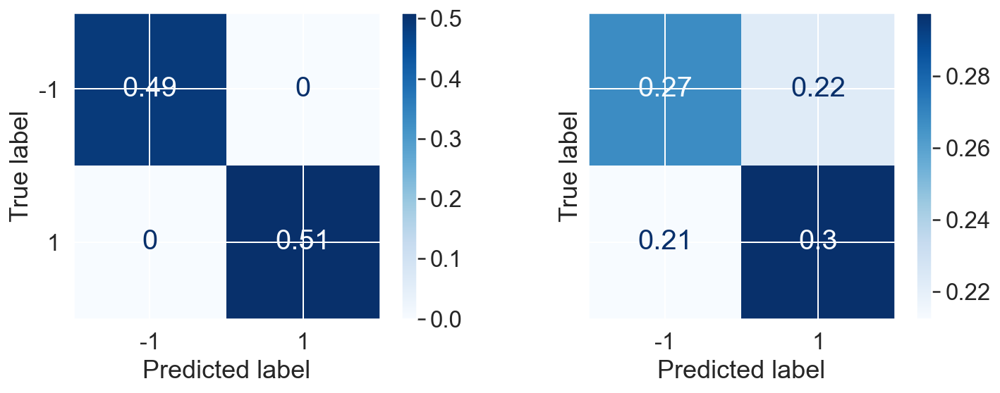

In [69]:
fig, ax = plt.subplots(ncols=2, figsize=(12, 4), sharey=True)
plot_confusion_matrix(bagging, Xstd_train1, y_train, cmap='Blues', ax=ax[0], normalize='all')
plot_confusion_matrix(bagging, Xstd_test1, y_test, cmap='Blues', ax=ax[1], normalize='all')

for a in ax:
    texts = a.texts
    for text in texts:
        text.set_size(20)

plt.show()

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.9s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.9s finished


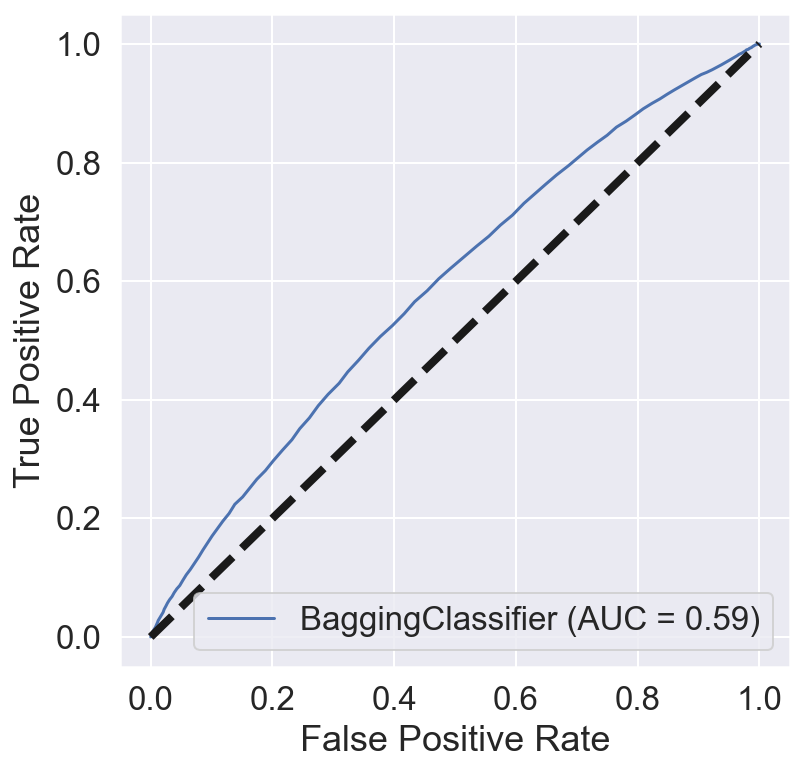

In [74]:
fig, ax = plt.subplots(figsize=(6, 6))
plot_roc_curve(bagging, Xstd_test1, y_test, ax=ax)
ax.plot([0, 1], [0, 1], 'k--', linewidth=4)
plt.show()

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.9s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.9s finished


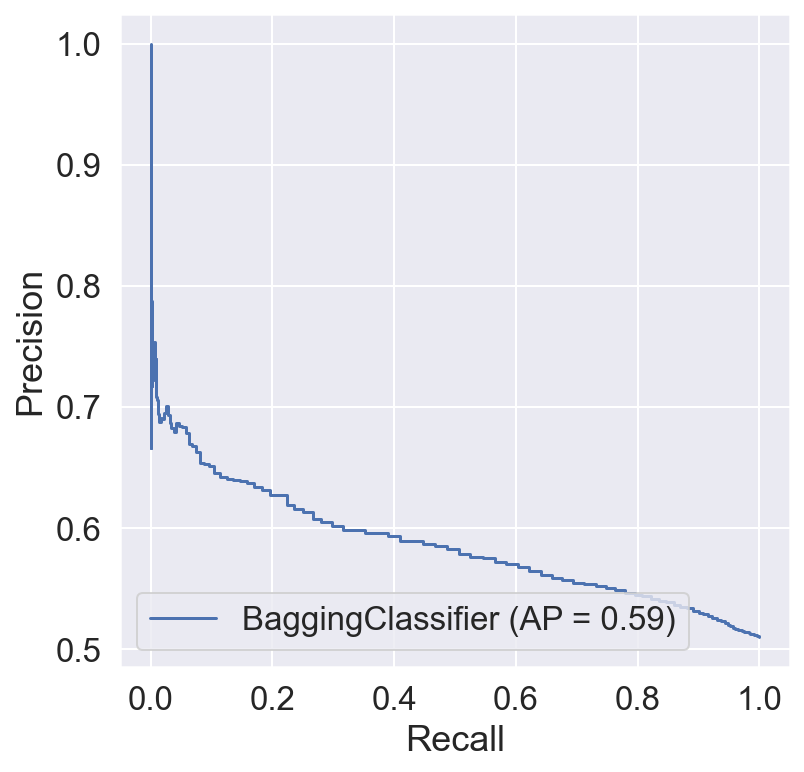

In [77]:
plt.fig, ax = plt.subplots(figsize=(6, 6))
plot_precision_recall_curve(bagging, Xstd_test1, y_test, ax=ax)
plt.show()

In [76]:
from sklearn.metrics import classification_report
print(classification_report(y_test, bagging.predict(Xstd_test1)))

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


              precision    recall  f1-score   support

          -1       0.56      0.55      0.55     14699
           1       0.57      0.58      0.58     15300

    accuracy                           0.57     29999
   macro avg       0.56      0.56      0.56     29999
weighted avg       0.57      0.57      0.57     29999



[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.9s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.9s finished


In [78]:
from sklearn.model_selection import GridSearchCV

In [276]:
params = {'max_samples': np.linspace(0.3, 1.0, 5),
          'max_features': range(int(1/2.*Xstd_train1.shape[1]), Xstd_train1.shape[1]+1),
           'n_estimators': [100]}

grid = GridSearchCV(bagging, param_grid=params, cv=5, n_jobs=-2)
grid.fit(Xstd_train1, y_train)
grid.best_estimator_

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


Building estimator 1 of 100 for this parallel run (total 100)...
Building estimator 2 of 100 for this parallel run (total 100)...
Building estimator 3 of 100 for this parallel run (total 100)...
Building estimator 4 of 100 for this parallel run (total 100)...
Building estimator 5 of 100 for this parallel run (total 100)...
Building estimator 6 of 100 for this parallel run (total 100)...
Building estimator 7 of 100 for this parallel run (total 100)...
Building estimator 8 of 100 for this parallel run (total 100)...
Building estimator 9 of 100 for this parallel run (total 100)...
Building estimator 10 of 100 for this parallel run (total 100)...
Building estimator 11 of 100 for this parallel run (total 100)...
Building estimator 12 of 100 for this parallel run (total 100)...
Building estimator 13 of 100 for this parallel run (total 100)...
Building estimator 14 of 100 for this parallel run (total 100)...
Building estimator 15 of 100 for this parallel run (total 100)...
Building estimator 

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.6s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.6s finished


BaggingClassifier(base_estimator=DecisionTreeClassifier(), max_features=12,
                  max_samples=0.825, n_estimators=100, verbose=10)

In [277]:
grid.best_score_

0.6393465415363225

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


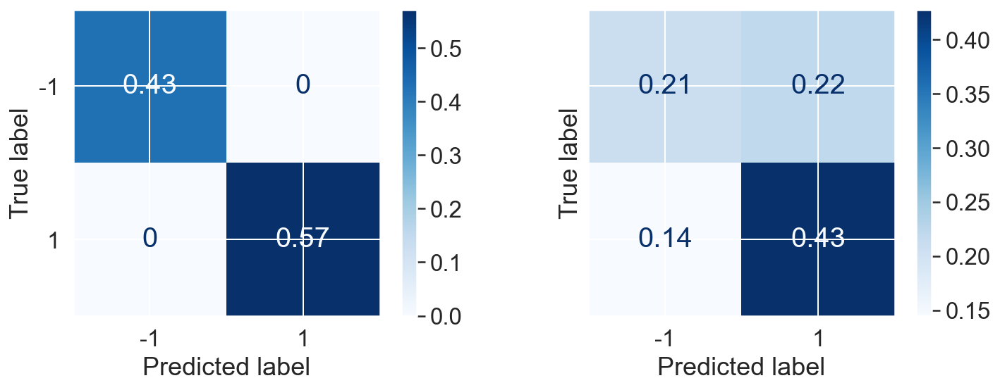

In [278]:
fig, ax = plt.subplots(ncols=2, figsize=(12, 4), sharey=True)
plot_confusion_matrix(grid, Xstd_train1, y_train, cmap='Blues', ax=ax[0], normalize='all')
plot_confusion_matrix(grid, Xstd_test1, y_test, cmap='Blues', ax=ax[1], normalize='all')

for a in ax:
    texts = a.texts
    for text in texts:
        text.set_size(20)

plt.show()

In [79]:
params_LogReg = {'Cs' : [np.logspace(-4, 4, 5)],
              'penalty' : ['l2','l1','elasticnet'],
              'max_iter' : [10000],
                 'l1_ratios' : [0.001, 0.01, 0.05, 0.1, 0.5]}
gs_LogReg = GridSearchCV(LogReg,params_LogReg,cv=5,verbose=10)
gs_LogReg.fit(Xstd_train1, y_train)

Fitting 5 folds for each of 15 candidates, totalling 75 fits
[CV] Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.001, max_iter=10000, penalty=l2 


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


[CV]  Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.001, max_iter=10000, penalty=l2, score=0.535, total=  22.6s
[CV] Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.001, max_iter=10000, penalty=l2 


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   22.5s remaining:    0.0s


[CV]  Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.001, max_iter=10000, penalty=l2, score=0.536, total=  14.5s
[CV] Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.001, max_iter=10000, penalty=l2 


[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   37.0s remaining:    0.0s


[CV]  Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.001, max_iter=10000, penalty=l2, score=0.546, total=  21.7s
[CV] Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.001, max_iter=10000, penalty=l2 


[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:   58.7s remaining:    0.0s


[CV]  Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.001, max_iter=10000, penalty=l2, score=0.549, total=  21.4s
[CV] Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.001, max_iter=10000, penalty=l2 


[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:  1.3min remaining:    0.0s


[CV]  Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.001, max_iter=10000, penalty=l2, score=0.537, total=  25.1s
[CV] Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.001, max_iter=10000, penalty=l1 


[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:  1.8min remaining:    0.0s


[CV]  Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.001, max_iter=10000, penalty=l1, score=0.535, total=  41.3s
[CV] Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.001, max_iter=10000, penalty=l1 


[Parallel(n_jobs=1)]: Done   6 out of   6 | elapsed:  2.4min remaining:    0.0s


[CV]  Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.001, max_iter=10000, penalty=l1, score=0.536, total= 1.5min
[CV] Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.001, max_iter=10000, penalty=l1 


[Parallel(n_jobs=1)]: Done   7 out of   7 | elapsed:  3.9min remaining:    0.0s


[CV]  Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.001, max_iter=10000, penalty=l1, score=0.547, total=  59.4s
[CV] Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.001, max_iter=10000, penalty=l1 


[Parallel(n_jobs=1)]: Done   8 out of   8 | elapsed:  4.9min remaining:    0.0s


[CV]  Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.001, max_iter=10000, penalty=l1, score=0.549, total=  49.3s
[CV] Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.001, max_iter=10000, penalty=l1 


[Parallel(n_jobs=1)]: Done   9 out of   9 | elapsed:  5.7min remaining:    0.0s


[CV]  Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.001, max_iter=10000, penalty=l1, score=0.537, total= 1.5min
[CV] Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.001, max_iter=10000, penalty=elasticnet 
[CV]  Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.001, max_iter=10000, penalty=elasticnet, score=nan, total=   0.0s
[CV] Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.001, max_iter=10000, penalty=elasticnet 
[CV]  Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.001, max_iter=10000, penalty=elasticnet, score=nan, total=   0.0s
[CV] Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.001, max_iter=10000, penalty=elasticnet 
[CV]  Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.001, max_iter=10000, penalty=elasticnet, score=nan, total=   0.0s
[CV] Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.001, max_iter=10000, penalty=elasticnet 
[CV]  Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.001, max_iter=10000, penalty=elasticnet, score=nan,

[CV]  Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.1, max_iter=10000, penalty=l2, score=0.549, total=  21.3s
[CV] Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.1, max_iter=10000, penalty=l2 
[CV]  Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.1, max_iter=10000, penalty=l2, score=0.537, total=  25.0s
[CV] Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.1, max_iter=10000, penalty=l1 
[CV]  Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.1, max_iter=10000, penalty=l1, score=0.535, total=  41.2s
[CV] Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.1, max_iter=10000, penalty=l1 
[CV]  Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.1, max_iter=10000, penalty=l1, score=0.536, total= 1.4min
[CV] Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.1, max_iter=10000, penalty=l1 
[CV]  Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.1, max_iter=10000, penalty=l1, score=0.547, total=  58.7s
[CV] Cs=[1.e-04 1.e-02 1.e+00 1.e+02 1.e+04], l1_ratios=0.1

[Parallel(n_jobs=1)]: Done  75 out of  75 | elapsed: 35.8min finished


GridSearchCV(cv=5, estimator=LogisticRegressionCV(solver='saga'),
             param_grid={'Cs': [array([1.e-04, 1.e-02, 1.e+00, 1.e+02, 1.e+04])],
                         'l1_ratios': [0.001, 0.01, 0.05, 0.1, 0.5],
                         'max_iter': [10000],
                         'penalty': ['l2', 'l1', 'elasticnet']},
             verbose=10)

In [80]:
gs_LogReg.best_params_

{'Cs': array([1.e-04, 1.e-02, 1.e+00, 1.e+02, 1.e+04]),
 'l1_ratios': 0.01,
 'max_iter': 10000,
 'penalty': 'l1'}

In [81]:
gs_LogReg.best_score_

0.5405738246609453

In [82]:
gs_LogReg.score(Xstd_test1,y_test)

0.5379845994866496

In [282]:
from sklearn.svm import SVC, LinearSVC

In [283]:
SVC1 = LinearSVC(loss='hinge', max_iter=5000, class_weight='balanced')
SVC2 = SVC(kernel='poly', gamma='scale', class_weight='balanced')

In [284]:
params_svm = {'C': np.logspace(-2, 2, 5),
              'gamma': np.linspace(0.01, 2, 5),
              'kernel': ['poly','linear','rbf']}
params_svm_poly = {'C': np.logspace(-2, 2, 5),
              'gamma': np.linspace(0.01, 2, 5),
              'kernel': ['poly'],
            'degree' : [2,3,4]}

In [285]:
print(cross_val_score(SVC1, Xstd_train1, y_train, cv=5, scoring='accuracy').mean())
print(cross_val_score(SVC2, Xstd_train1, y_train, cv=5, scoring='accuracy').mean())

0.5200850244645865
0.5325231945669902


In [287]:
SVC1.fit(Xstd_train1, y_train)
SVC2.fit(Xstd_train1, y_train)

SVC(class_weight='balanced', kernel='poly')

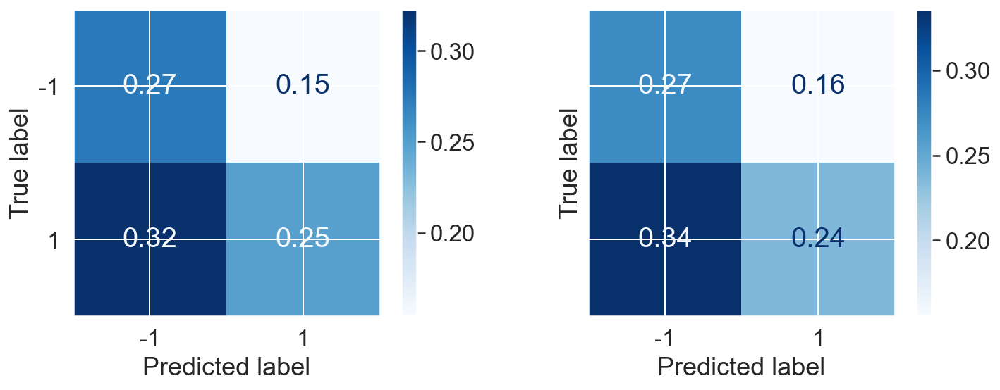

In [288]:
fig, ax = plt.subplots(ncols=2, figsize=(12, 4), sharey=True)
plot_confusion_matrix(SVC1, Xstd_train1, y_train, cmap='Blues', ax=ax[0], normalize='all')
plot_confusion_matrix(SVC1, Xstd_test1, y_test, cmap='Blues', ax=ax[1], normalize='all')

for a in ax:
    texts = a.texts
    for text in texts:
        text.set_size(20)

plt.show()

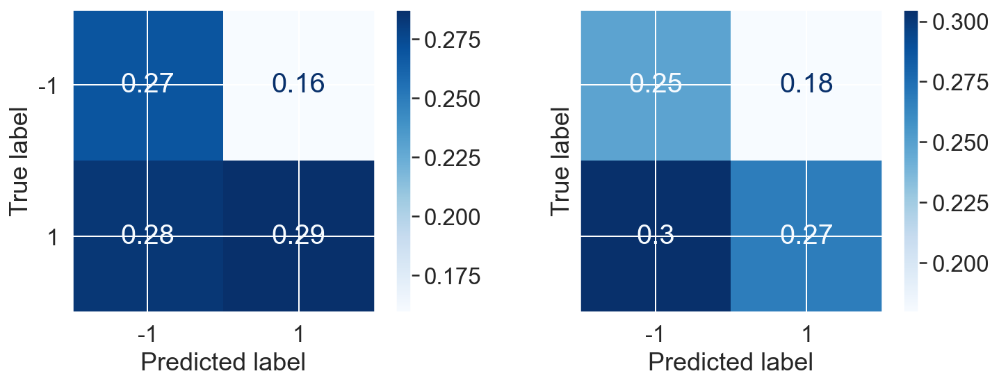

In [289]:
fig, ax = plt.subplots(ncols=2, figsize=(12, 4), sharey=True)
plot_confusion_matrix(SVC2, Xstd_train1, y_train, cmap='Blues', ax=ax[0], normalize='all')
plot_confusion_matrix(SVC2, Xstd_test1, y_test, cmap='Blues', ax=ax[1], normalize='all')

for a in ax:
    texts = a.texts
    for text in texts:
        text.set_size(20)

plt.show()

In [290]:
SVC3 = SVC()
gridsvm = GridSearchCV(SVC3, param_grid=params_svm, cv=5, n_jobs=-2,verbose=10)
gridsvm.fit(Xstd_train1, y_train)
gridsvm.best_estimator_

Fitting 5 folds for each of 75 candidates, totalling 375 fits


[Parallel(n_jobs=-2)]: Using backend LokyBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Done   4 tasks      | elapsed:    4.6s
[Parallel(n_jobs=-2)]: Done  11 tasks      | elapsed:    4.7s
[Parallel(n_jobs=-2)]: Done  18 tasks      | elapsed:    4.8s
[Parallel(n_jobs=-2)]: Done  27 tasks      | elapsed:    4.9s
[Parallel(n_jobs=-2)]: Done  36 tasks      | elapsed:    5.0s
[Parallel(n_jobs=-2)]: Batch computation too fast (0.1986s.) Setting batch_size=2.
[Parallel(n_jobs=-2)]: Done  47 tasks      | elapsed:    5.1s
[Parallel(n_jobs=-2)]: Done  58 tasks      | elapsed:    5.2s
[Parallel(n_jobs=-2)]: Batch computation too fast (0.1506s.) Setting batch_size=4.
[Parallel(n_jobs=-2)]: Done  79 tasks      | elapsed:    5.4s
[Parallel(n_jobs=-2)]: Done 119 tasks      | elapsed:    5.9s
[Parallel(n_jobs=-2)]: Done 179 tasks      | elapsed:    6.5s
[Parallel(n_jobs=-2)]: Done 239 tasks      | elapsed:    7.2s
[Parallel(n_jobs=-2)]: Done 307 tasks      | elapsed:    9.2s
[Parallel(n_jo

SVC(C=100.0, gamma=2.0)

In [291]:
gridsvm.best_score_

0.5845057618780246

In [292]:
SVC4 = SVC(kernel='poly')
gridsvm = GridSearchCV(SVC4, param_grid=params_svm_poly, cv=5, n_jobs=-2,verbose=10)
gridsvm.fit(Xstd_train1, y_train)
gridsvm.best_estimator_

Fitting 5 folds for each of 75 candidates, totalling 375 fits


[Parallel(n_jobs=-2)]: Using backend LokyBackend with 7 concurrent workers.
[Parallel(n_jobs=-2)]: Batch computation too fast (0.0628s.) Setting batch_size=2.
[Parallel(n_jobs=-2)]: Done   4 tasks      | elapsed:    0.0s
[Parallel(n_jobs=-2)]: Done  11 tasks      | elapsed:    0.1s
[Parallel(n_jobs=-2)]: Batch computation too fast (0.1705s.) Setting batch_size=4.
[Parallel(n_jobs=-2)]: Done  22 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-2)]: Done  40 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-2)]: Done  74 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-2)]: Done 118 tasks      | elapsed:    1.2s
[Parallel(n_jobs=-2)]: Done 162 tasks      | elapsed:    1.7s
[Parallel(n_jobs=-2)]: Done 214 tasks      | elapsed:    2.4s
[Parallel(n_jobs=-2)]: Done 266 tasks      | elapsed:    4.3s
[Parallel(n_jobs=-2)]: Batch computation too slow (2.1171s.) Setting batch_size=1.
[Parallel(n_jobs=-2)]: Done 326 tasks      | elapsed:   10.7s
[Parallel(n_jobs=-2)]: Done 350 tasks      | elapsed:  

SVC(C=0.1, degree=4, gamma=2.0, kernel='poly')

In [293]:
gridsvm.best_params_

{'C': 0.1, 'degree': 4, 'gamma': 2.0, 'kernel': 'poly'}

In [295]:
gridsvm.best_score_

0.5801181786583246

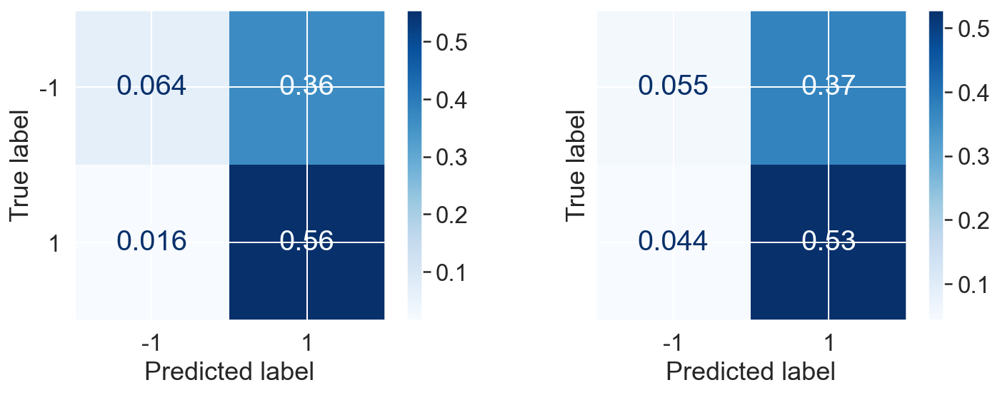

In [296]:
fig, ax = plt.subplots(ncols=2, figsize=(12, 4), sharey=True)
plot_confusion_matrix(gridsvm, Xstd_train1, y_train, cmap='Blues', ax=ax[0], normalize='all')
plot_confusion_matrix(gridsvm, Xstd_test1, y_test, cmap='Blues', ax=ax[1], normalize='all')

for a in ax:
    texts = a.texts
    for text in texts:
        text.set_size(20)

plt.show()